In [180]:
import numpy as np
import pickle

In [181]:
from sklearn.datasets import load_iris
from sklearn import tree
from sklearn.model_selection import cross_val_score, cross_val_predict
from sklearn.metrics import confusion_matrix

## Load the features

In [255]:
with open('../cache/features','rb') as f:
    X, y, imgNames = pickle.load(f)
X.shape

(598, 11)

In [256]:
X

,left_minus_right,mean,middle_max,middle_min,middle_minus_left,middle_minus_right,middle_n_peaks,middle_prec_raised,middle_row_max,pre_norm_max,pre_norm_range
0,0.001482,0.650116,0.884444,0.284444,0.000092,0.001391,0.0,0.003094,0.360000,225.0,202.0
1,0.006381,0.619079,0.885572,0.238806,0.002460,0.008841,11.0,0.245000,0.527363,201.0,193.0
2,0.003976,0.613970,0.973451,0.243363,0.004476,0.008453,8.0,0.026719,0.376106,226.0,199.0
3,0.004076,0.552680,0.920000,0.280000,0.001505,0.002571,14.0,0.167000,0.426667,225.0,206.0
4,0.002386,0.619940,0.768889,0.182222,0.001501,0.000885,5.0,0.000281,0.386667,209.0,190.0
5,0.003237,0.652965,0.805556,0.287037,0.001519,0.001717,2.0,0.000812,0.625000,216.0,200.0
6,0.005664,0.534487,0.946903,0.159292,0.001078,0.004586,27.0,0.216125,0.473451,226.0,212.0
7,0.002350,0.634305,0.991150,0.384956,0.009170,0.011520,0.0,0.048406,0.367257,226.0,202.0
8,0.002007,0.673598,0.813084,0.415888,0.000946,0.001061,1.0,0.000531,0.434579,200.0,176.0
9,0.002182,0.556852,0.729412,0.231373,0.000785,0.001397,2.0,0.001313,0.356863,219.0,195.0


In [257]:
y.mean()

0.5635451505016722

## Evalutate a Decision Tree Model via Cross-Validation

In [258]:
clf = tree.DecisionTreeClassifier(max_depth=5, min_samples_leaf=5).fit(X, y)

In [260]:
scores = cross_val_score(clf, X, y, cv=10)
print("Accuracy: %0.2f (+/- %0.2f)" % (scores.mean(), scores.std() * 2))

Accuracy: 0.69 (+/- 0.19)


In [261]:
y_pred = cross_val_predict(clf, X, y, cv=10)
confusion_matrix(y, y_pred)

array([[186,  75],
       [107, 230]])

In [270]:
import graphviz 
dot_data = tree.export_graphviz(clf, out_file=None, feature_names=X.columns,                             
                         filled=True, rounded=True,  
                         special_characters=True)
graph = graphviz.Source(dot_data) 
graph.render("decicition_tree") 

'decicition_tree.pdf'

In [268]:
X.columns

Index(['left_minus_right', 'mean', 'middle_max', 'middle_min',
       'middle_minus_left', 'middle_minus_right', 'middle_n_peaks',
       'middle_prec_raised', 'middle_row_max', 'pre_norm_max',
       'pre_norm_range'],
      dtype='object')

## Look at bad examples

In [263]:
from PIL import Image
import imageio

def printWaterfall(file):
    im = imageio.imread(file)
    display(Image.fromarray(im))

   left_minus_right     mean  middle_max  middle_min  middle_minus_left  \
4          0.002386  0.61994    0.768889    0.182222           0.001501   

   middle_minus_right  middle_n_peaks  middle_prec_raised  middle_row_max  \
4            0.000885             5.0            0.000281        0.386667   

   pre_norm_max  pre_norm_range  
4         209.0           190.0  


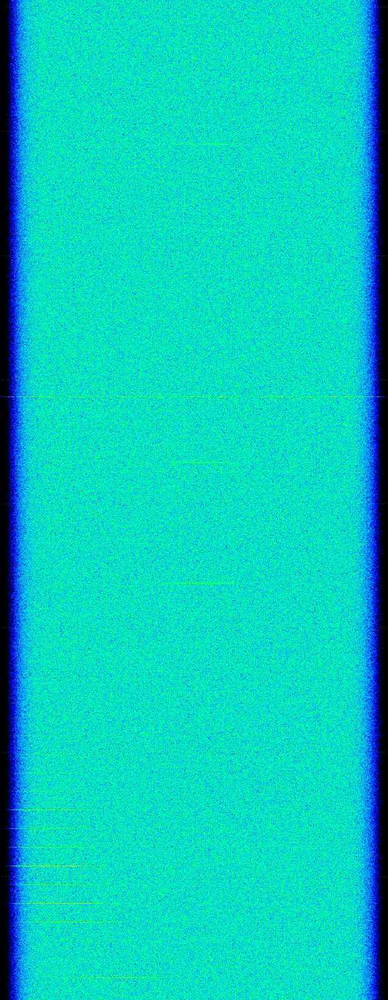

   left_minus_right      mean  middle_max  middle_min  middle_minus_left  \
8          0.002007  0.673598    0.813084    0.415888           0.000946   

   middle_minus_right  middle_n_peaks  middle_prec_raised  middle_row_max  \
8            0.001061             1.0            0.000531        0.434579   

   pre_norm_max  pre_norm_range  
8         200.0           176.0  


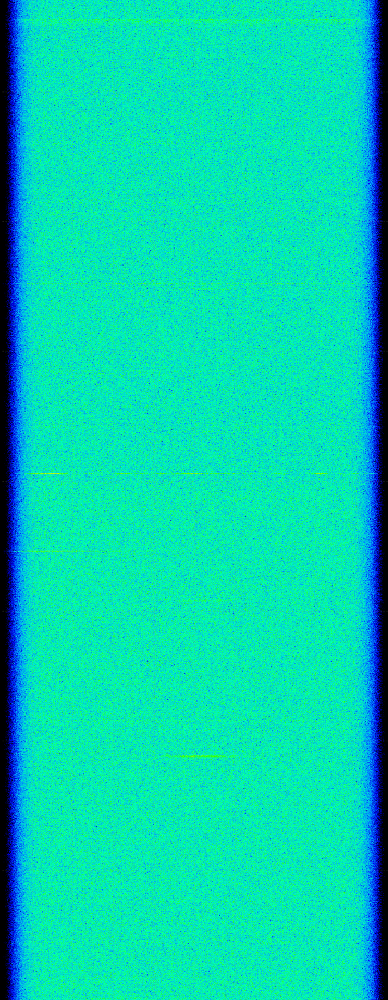

   left_minus_right      mean  middle_max  middle_min  middle_minus_left  \
9          0.002182  0.556852    0.729412    0.231373           0.000785   

   middle_minus_right  middle_n_peaks  middle_prec_raised  middle_row_max  \
9            0.001397             2.0            0.001313        0.356863   

   pre_norm_max  pre_norm_range  
9         219.0           195.0  


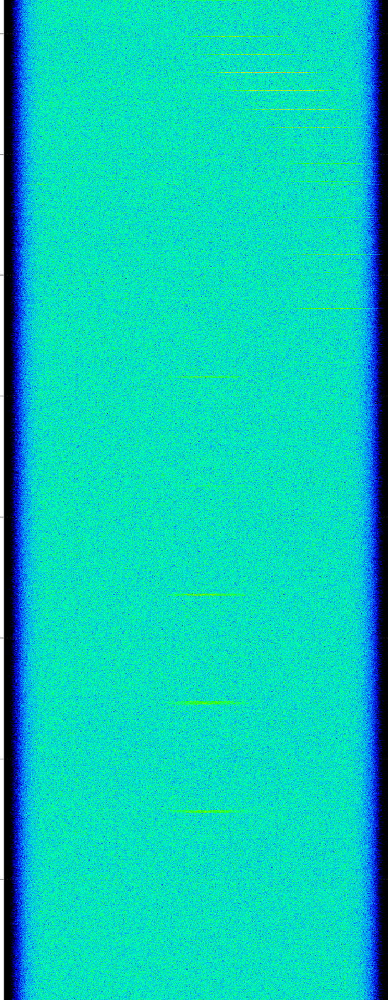

    left_minus_right      mean  middle_max  middle_min  middle_minus_left  \
10          0.005085  0.656348    0.924731    0.123656           0.002392   

    middle_minus_right  middle_n_peaks  middle_prec_raised  middle_row_max  \
10            0.002693            31.0            0.205219         0.55914   

    pre_norm_max  pre_norm_range  
10         178.0           167.0  


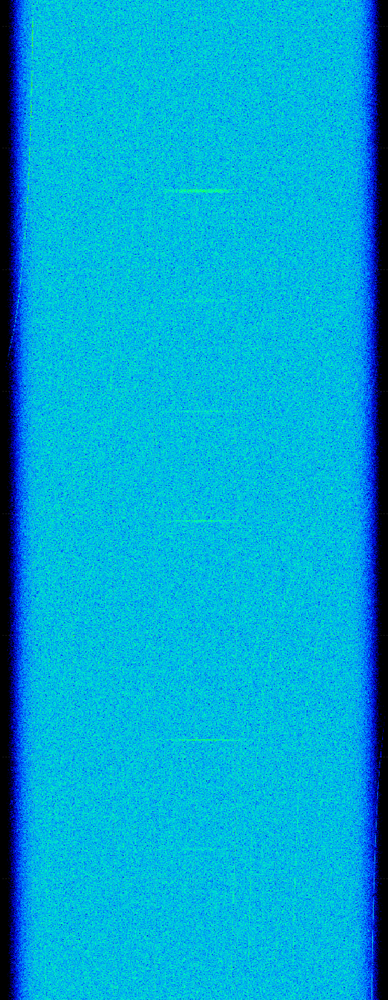

    left_minus_right      mean  middle_max  middle_min  middle_minus_left  \
11          0.006533  0.705919    0.988636    0.164773            0.00316   

    middle_minus_right  middle_n_peaks  middle_prec_raised  middle_row_max  \
11            0.003373            18.0            0.189469        0.613636   

    pre_norm_max  pre_norm_range  
11         175.0           170.0  


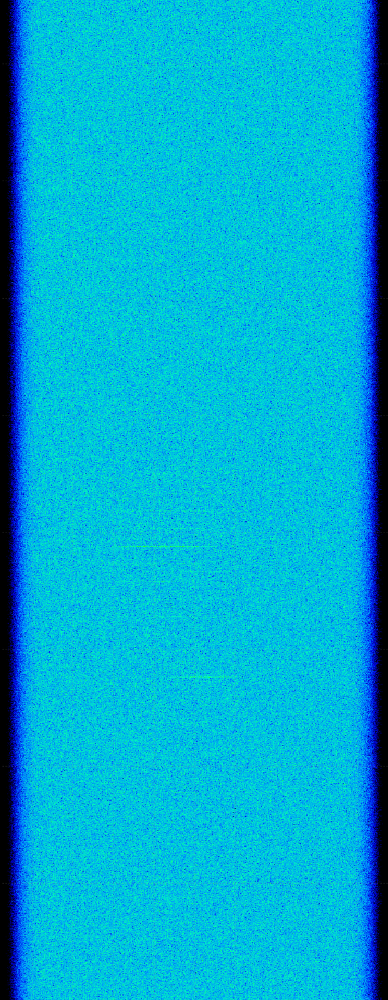

In [264]:
is_false_negative = np.where(np.logical_and(y == 1, y_pred == 0))[0]
for idx in is_false_negative[:5]:
    print(X.iloc[[idx]])
    printWaterfall('../data/cropped/good/' + imgNames[idx])

   left_minus_right      mean  middle_max  middle_min  middle_minus_left  \
1          0.001639  0.722448    0.977654    0.240223           0.003392   

   middle_minus_right  middle_n_peaks  middle_prec_raised  middle_row_max  \
1            0.001754            11.0            0.166781        0.547486   

   pre_norm_max  pre_norm_range  
1         179.0           157.0  


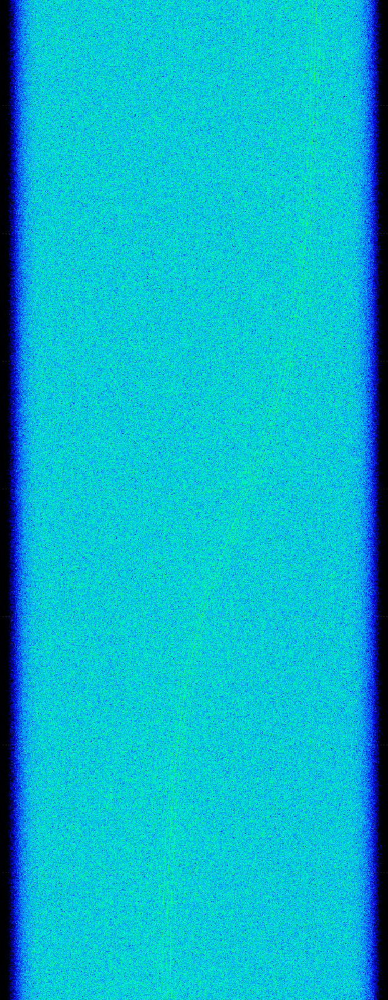

   left_minus_right      mean  middle_max  middle_min  middle_minus_left  \
2          0.003489  0.666157     0.80531    0.469027           0.000096   

   middle_minus_right  middle_n_peaks  middle_prec_raised  middle_row_max  \
2            0.003393             0.0             0.00175        0.269912   

   pre_norm_max  pre_norm_range  
2         226.0           173.0  


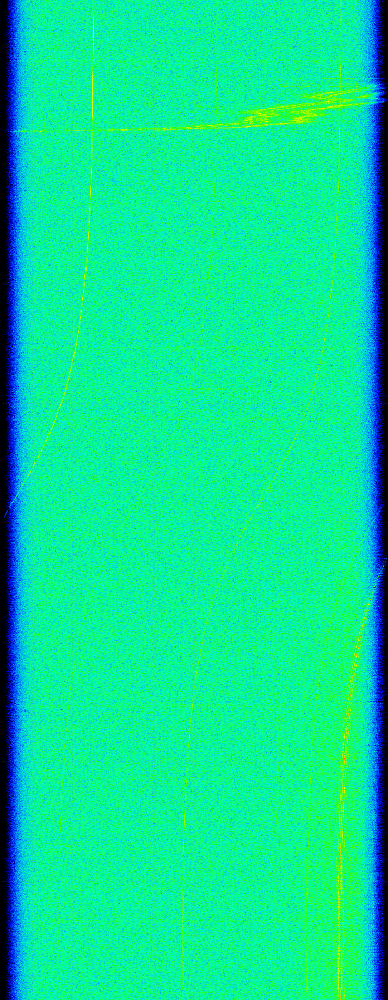

   left_minus_right      mean  middle_max  middle_min  middle_minus_left  \
5          0.004669  0.689646    0.971751    0.225989           0.003513   

   middle_minus_right  middle_n_peaks  middle_prec_raised  middle_row_max  \
5            0.001156            30.0            0.180844        0.559322   

   pre_norm_max  pre_norm_range  
5         175.0           154.0  


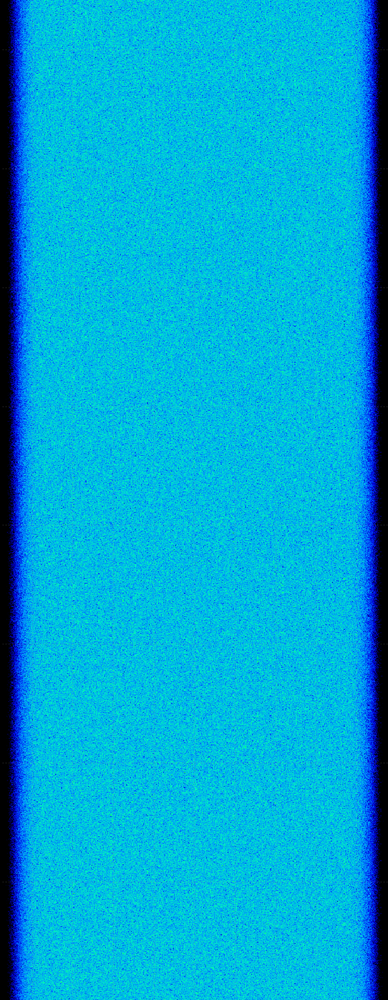

   left_minus_right      mean  middle_max  middle_min  middle_minus_left  \
7          0.014074  0.601046    0.933628    0.327434           0.013336   

   middle_minus_right  middle_n_peaks  middle_prec_raised  middle_row_max  \
7            0.000738             2.0            0.032875        0.402655   

   pre_norm_max  pre_norm_range  
7         226.0           209.0  


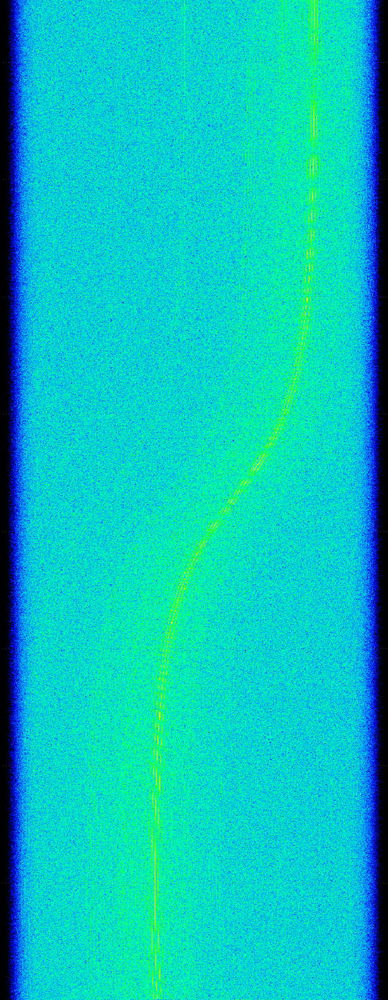

   left_minus_right      mean  middle_max  middle_min  middle_minus_left  \
8          0.104672  0.177273    0.889381    0.004425             0.0236   

   middle_minus_right  middle_n_peaks  middle_prec_raised  middle_row_max  \
8            0.081072           304.0            0.196594        0.402655   

   pre_norm_max  pre_norm_range  
8         225.0           225.0  


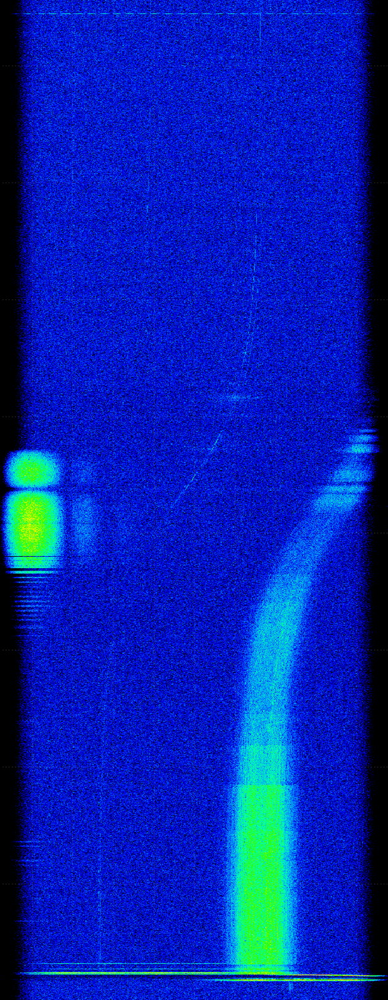

In [266]:
is_false_positive = np.where(np.logical_and(y == 0, y_pred == 1))[0]
for idx in is_false_positive[:5]:
    print(X.iloc[[idx]])
    printWaterfall('../data/cropped/bad/' + imgNames[idx])